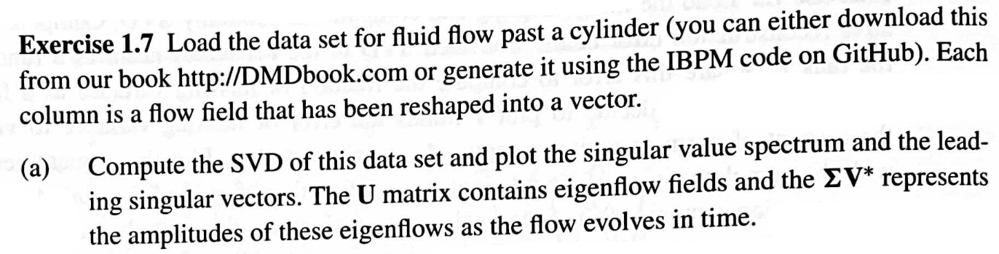

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams
from scipy import io
import os

rcParams.update({'font.size': 18})
plt.rcParams['figure.figsize'] = [8, 8]

In [7]:
vortall_mat = io.loadmat(os.path.join('.','DATA','VORTALL.mat'))
X = vortall_mat['VORTALL']
# VORTALL contains flow fields reshaped into column vectors

In [132]:
U,Sigma,VT = np.linalg.svd(X,full_matrices=0) # SVD of data

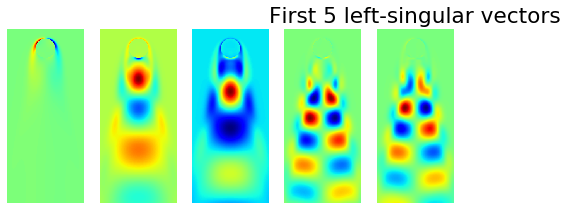

In [123]:
#Plotting first 5 left-singular vectors
fig, axs = plt.subplots(1,5)
for i in range(5):
    V = np.copy(np.real(np.reshape(U[:,i],(449,199))))
    axs[i].imshow(V, cmap = 'jet')
    axs[i].axis('off')
plt.title("First 5 left-singular vectors")
plt.show()

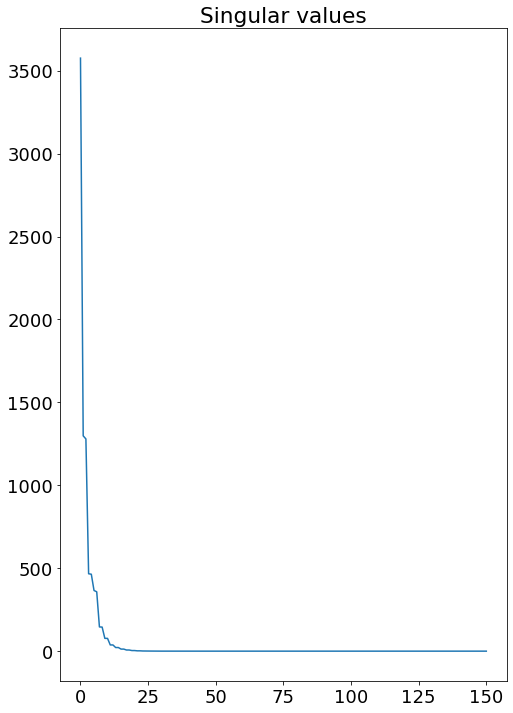

In [122]:
#Plot singular values
plt.plot(Sigma)
plt.title("Singular values")
plt.show()

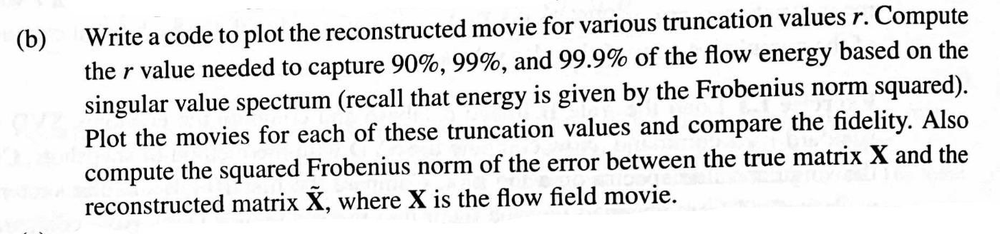

In [91]:
from PIL import Image

In [100]:
imgs = []
for i in range(150):
    V = np.copy(np.real(np.reshape(X[:,i],(449,199))))
    V = 255 * V
    imgs.append(Image.fromarray(np.uint8(V)))

#imgs[1].shape
#imgs  = Image.fromarray(imgs[2])
#imgs.show()
imgs[0].save("vortices.gif", save_all=True, append_images=imgs[1:], duration=10, loop=0)

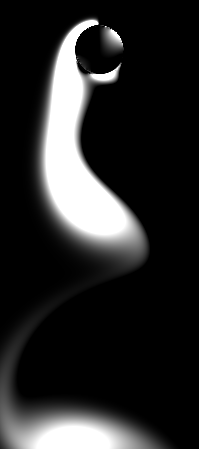

In [83]:
filenames = []
for i in range(150):
    V = np.copy(np.real(np.reshape(X[:,i],(449,199))))
    plt.imshow(V, cmap = 'jet')
    filename = './pics/full'+str(i)+'.png'
    filenames.append(filename)
    plt.savefig(filename)
    plt.close()

In [95]:
#!pip install imageio

In [98]:
import imageio
with imageio.get_writer('vortices.gif', mode='I') as writer:
    for filename in filenames:
        image = imageio.v2.imread(filename)
        writer.append_data(image)
for filename in set(filenames):
    os.remove(filename)

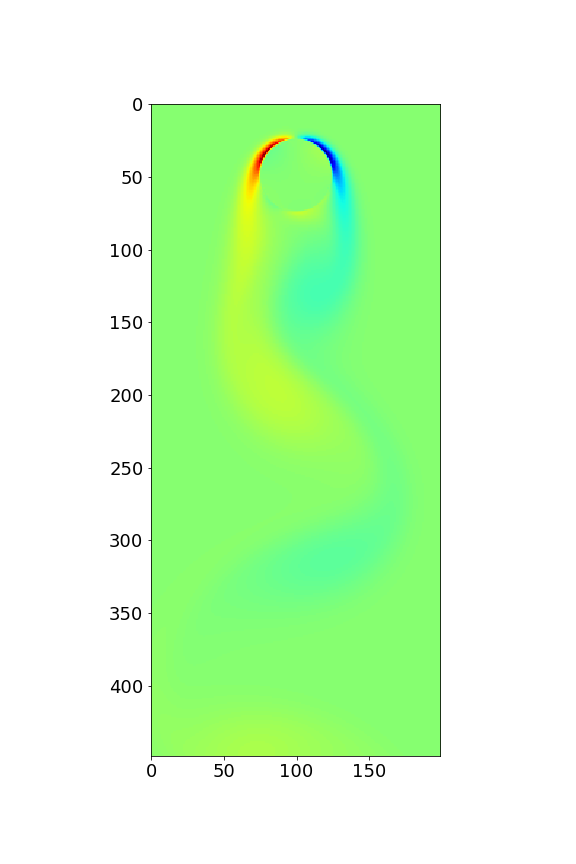